In [1]:
!pip install -U transformers diffusers accelerate openai sentencepiece bitsandbytes

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 65.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.0/280.0 kB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.7/226.7 kB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 51.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.0/105.0 MB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.9/75.9 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.0/77.0 kB 5.0 MB/s eta 0:00:00
  Attempting uninstall: sentencepiece
    Found existing installation: sentencepiece 0.1.99
    Uninstalling sentencepiece-0.1.99:
      Successfully uninstalled sentencepiece-0.1.99
  Attempting uninstall: accelerate
    Found existing installation: accelerate 0.26.1
    Uninstalling acc

In [2]:
import numpy as np
import pandas as pd
import os
import torch
from PIL import Image

# OpenAI imports 
from openai import OpenAI
from kaggle_secrets import UserSecretsClient

import base64
import requests
import cv2 


In [3]:
class CFG:
    model1 = "gpt-4-vision-preview"
    CONV_MODE = "llava_v0"
    device = 'cuda'
    
# setup OpenAI connection
user_secrets = UserSecretsClient()
secret_value_0 = user_secrets.get_secret("openaivision")    

In [4]:

# Function to encode the image
def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


In [5]:
# GPT4-vision setup
client = OpenAI(api_key= secret_value_0)

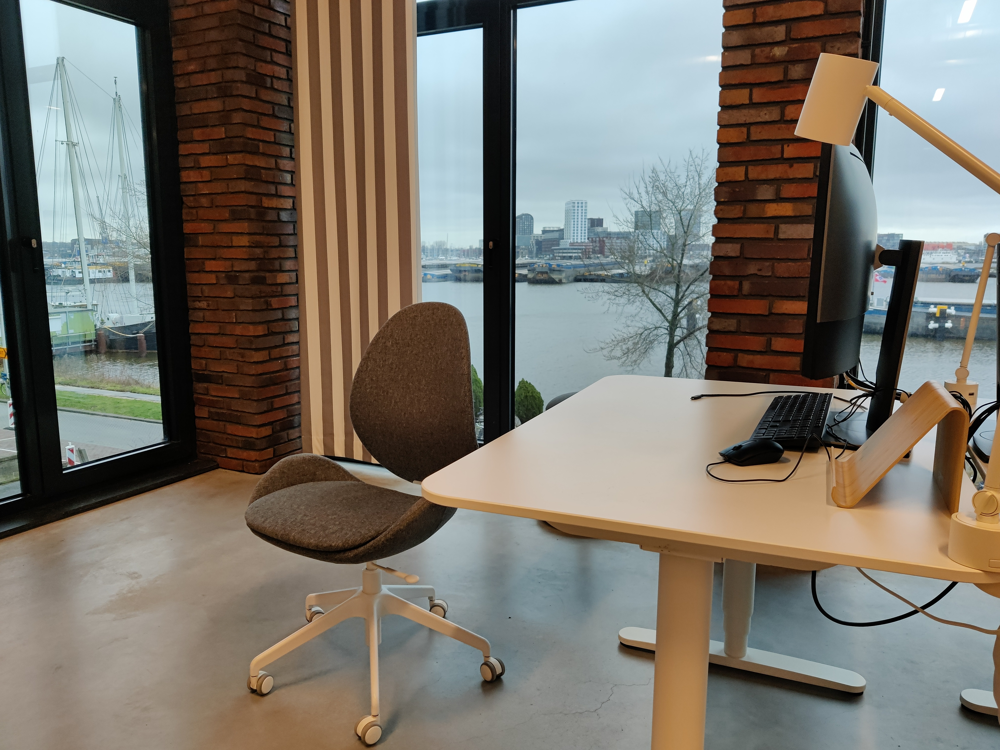

In [6]:
# img1 

image_path = "/kaggle/input/officephotos/IMG_20240219_131711.jpg"

image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image = Image.fromarray(np.uint8(image))


image


In [7]:

base64_image = encode_image(image_path)


prompt = "Describe the image in a step by step manner."

response = client.chat.completions.create(
  model= CFG.model1,
  messages=[
    {
      "role": "user",
      "content": [
        {"type": "text", "text": prompt},
        {
          "type": "image_url",  "image_url": { "url": f"data:image/jpeg;base64,{base64_image}", },
        }, ], } ],
  max_tokens=512,
)

print(response.choices[0].message.content)

This image features an office setting with a view of a waterfront area through large windows. Here's a step-by-step description:

1. In the foreground, there's a fabric office chair with a modern design, placed to the left. This chair has wheels and is colored in shades of grey.

2. To the right of the chair, there's a white office desk. The desk appears to be height-adjustable and has a control panel on the right edge. 

3. On the desk, there's a desktop setup that includes a large, curved monitor positioned at the desk's center. To the right of the monitor, there's a keyboard and a mouse, both connected by wires.

4. Behind the monitor, there's a desk lamp with a wooden frame and a white lampshade. 

5. The interior walls are partially lined with exposed brick, in a red-brown color, giving the space an industrial-modern feel. Two brick columns, one to the far left and one to the right of the desk, frame the window sections.

6. Over the window, semi-transparent vertical blinds are pa

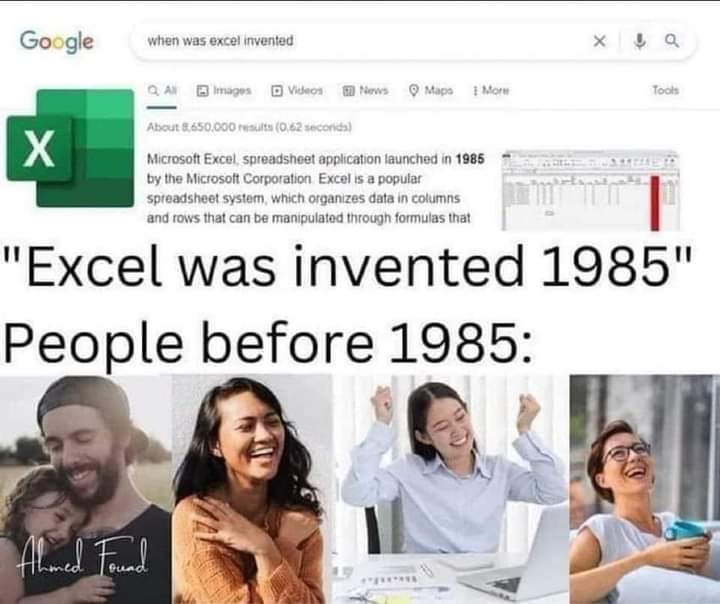

In [8]:
# img2 

image_path = "/kaggle/input/officephotos/F-wMuXFWkAAH3XH.jpg"

image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image = Image.fromarray(np.uint8(image))


image


In [9]:

base64_image = encode_image(image_path)


prompt = "Explain this meme."

response = client.chat.completions.create(
  model= CFG.model1,
  messages=[
    {
      "role": "user",
      "content": [
        {"type": "text", "text": prompt},
        {
          "type": "image_url",  "image_url": { "url": f"data:image/jpeg;base64,{base64_image}", },
        }, ], } ],
  max_tokens=512,
)

print(response.choices[0].message.content)

This meme is playing with the idea that people were somehow unable to manage certain tasks before the invention of a specific tool—in this case, Microsoft Excel, which is described as being launched in 1985. It humorously suggests that, because Excel is now so central to many business and organizational tasks like data management, accounting, and analysis, people before its invention must have been unable to handle such tasks.

In the image, the meme states "Excel was invented in 1985" and then shows a series of photos of people laughing and having a good time with the caption "People before 1985." This humorous contrast implies that people were blissfully unaware of the complexities of data management that Excel would later help to solve, thus they were depicted as being carefree and happy.

Of course, in reality, people used a variety of methods to manage data before computer spreadsheets, including manual ledgers, calculators, and earlier forms of electronic data processing. The mem

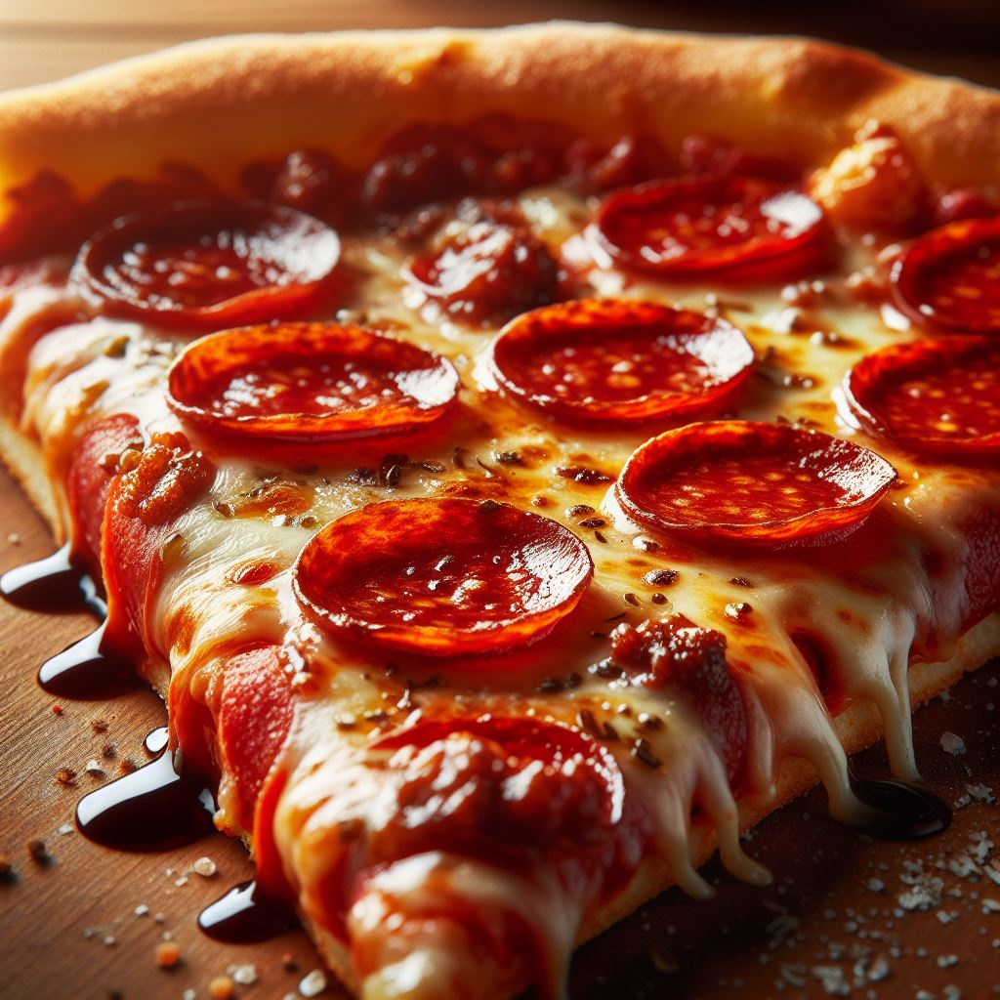

In [10]:
# img3 

image_path = "/kaggle/input/officephotos/OIG1.jpg"

image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image = Image.fromarray(np.uint8(image))


image


In [11]:

base64_image = encode_image(image_path)


prompt = "Provide a step by step details of how to prepare this dish."

response = client.chat.completions.create(
  model= CFG.model1,
  messages=[
    {
      "role": "user",
      "content": [
        {"type": "text", "text": prompt},
        {
          "type": "image_url",  "image_url": { "url": f"data:image/jpeg;base64,{base64_image}", },
        }, ], } ],
  max_tokens=512,
)

print(response.choices[0].message.content)

That's a delicious-looking slice of pepperoni pizza. Here's a step-by-step guide to making a classic pepperoni pizza from scratch:

### Ingredients
- 2 1/4 teaspoons active dry yeast (one 1/4-ounce packet)
- 1 1/3 cups warm water (around 110°F)
- 3 1/2 cups all-purpose flour, plus extra for dusting
- 2 tablespoons olive oil, plus extra for greasing
- 2 teaspoons salt
- 1 teaspoon sugar
- 1 cup pizza sauce (store-bought or homemade)
- 2 to 2 1/2 cups shredded mozzarella cheese
- Pepperoni slices
- 1/2 teaspoon dried oregano (optional, for garnish)
- Red pepper flakes (optional, for serving)

### Instructions

#### Step 1: Prepare the Pizza Dough
1. **Activate the yeast:** In a small bowl, dissolve sugar in warm water. Sprinkle yeast on top. Let it stand for 10 minutes or until the mixture becomes frothy.
2. **Combine the dry ingredients:** In a large mixing bowl, combine the flour and salt.
3. **Mix the wet ingredients:** Add the olive oil and the yeast mixture to the dry ingredients. M

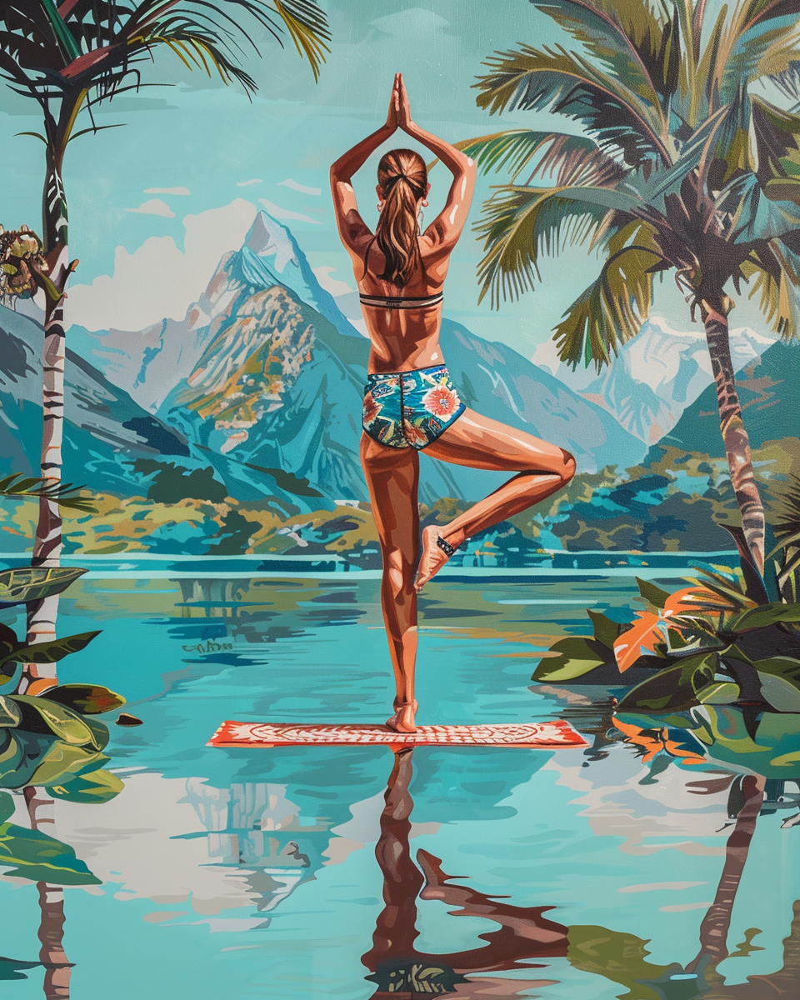

In [12]:
# img4 

image_path = "/kaggle/input/officephotos/exp_image1.png"

image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image = Image.fromarray(np.uint8(image))


image


In [13]:

base64_image = encode_image(image_path)


prompt = "Describe the image in a step by step manner."

response = client.chat.completions.create(
  model= CFG.model1,
  messages=[
    {
      "role": "user",
      "content": [
        {"type": "text", "text": prompt},
        {
          "type": "image_url",  "image_url": { "url": f"data:image/jpeg;base64,{base64_image}", },
        }, ], } ],
  max_tokens=512,
)

print(response.choices[0].message.content)

The image is an illustration depicting a serene tropical scene with a focus on a figure practicing yoga. Here's the step-by-step description:

1. In the foreground, there is a person standing on a patterned yoga mat positioned on a tranquil, reflective body of water, suggesting a shallow lake or a large calm pool.
2. The individual is shown from behind, in the middle of performing a tree pose (Vrksasana) — a common balancing pose in yoga — with the left foot pressed against the inner thigh of the right leg, hands pressed together in a prayer position above the head.
3. This individual appears to be a woman with her hair tied in a braid that drapes down her back. She is wearing patterned shorts and appears to be bare-chested, suggesting a liberating and close-to-nature yoga practice.
4. The setting is tropical, surrounded by palm trees and lush foliage, with flowers brightly colored in orange and pink hues, hinting at a warm and exotic location.
5. Beyond the trees, there is a striking 